<a href="https://colab.research.google.com/github/VKSi/2021_07_GB_ComputerVision/blob/main/HW_8_DGGAN.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Синтез изображений. Часть 2. Генеративно-Состязательная Сеть (GAN)     
Реализовать синтезирование лиц из LFW с помощью DCGAN     
Библиотеки: [Python, Tensorflow]

In [ ]:
from google.colab import drive, files
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [ ]:
PATH = '/content/gdrive/My Drive/AI/GB/CV/'
PATH_L8 = PATH + 'Lesson8/'

## Переключение версии TensorFlow

In [ ]:
%tensorflow_version 2.x

In [ ]:
%matplotlib inline
import matplotlib.pyplot as plt
import numpy as np
# from sklearn.manifold import TSNE

import tensorflow as tf
import tensorflow_datasets as tfds

## Загрузка и подготовка датасета LFW
https://www.tensorflow.org/datasets/catalog/lfw 

In [ ]:
tfds.disable_progress_bar()
ds, info = tfds.load(
    'lfw', 
    as_supervised=True,
    with_info=True,
)

Shuffling and writing examples to /root/tensorflow_datasets/lfw/0.1.0.incompleteSRPXT9/lfw-train.tfrecord
Dataset lfw downloaded and prepared to /root/tensorflow_datasets/lfw/0.1.0. Subsequent calls will reuse this data.


In [ ]:
info

tfds.core.DatasetInfo(
    name='lfw',
    version=0.1.0,
    description='Labeled Faces in the Wild:
        A Database for Studying Face Recognition in
        Unconstrained Environments',
    homepage='http://vis-www.cs.umass.edu/lfw',
    features=FeaturesDict({
        'image': Image(shape=(250, 250, 3), dtype=tf.uint8),
        'label': Text(shape=(), dtype=tf.string),
    }),
    total_num_examples=13233,
    splits={
        'train': 13233,
    },
    supervised_keys=('label', 'image'),
    citation="""@TechReport{LFWTech,
        author = {Gary B. Huang and Manu Ramesh and Tamara Berg and Erik Learned-Miller},
        title = {Labeled Faces in the Wild: A Database for Studying Face Recognition in Unconstrained Environments},
        institution = {University of Massachusetts, Amherst},
        year = 2007,
        number = {07-49},
        month = {October}
    }""",
    redistribution_info=,
)

Из info видно, что датасет содержит только train часть, выделять из нее сет для валидации будем потом вручную

In [ ]:
train_ds = ds['train']

In [ ]:
train_ds

<PrefetchDataset shapes: ((), (250, 250, 3)), types: (tf.string, tf.uint8)>

## Визуализация датасета LFW

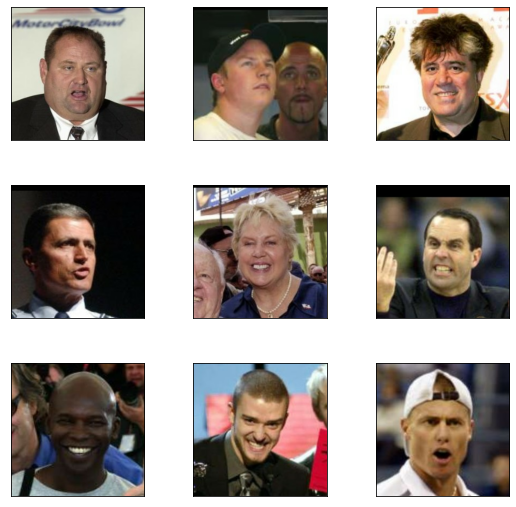

In [ ]:
fig = tfds.show_examples(train_ds, info)

Таким способом не прописались лейблы, попробуем другим

,image,label
0,,Tom_Amstutz
1,,Kimi_Raikkonen
2,,Pedro_Almodovar
3,,John_Rosa

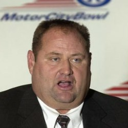
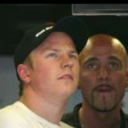
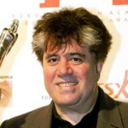
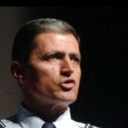

In [ ]:
tfds.as_dataframe(train_ds.take(4), info)

Видно, что лейблы даны в текстовом формате, что выглядит немного странно, так как два разных Ивана Иванова будут отнесены к одному классу

In [ ]:
labels = set([x[0].numpy() for x in ds['train']])
len(labels)

5749

### Разделим датасет на две части

In [ ]:
DATASET_SIZE = 13233

In [ ]:
train_size = int(0.7 * DATASET_SIZE)
test_size = int(0.3 * DATASET_SIZE)

train_ds_sh = train_ds.shuffle(buffer_size=DATASET_SIZE)

train_dataset = train_ds_sh.take(train_size)
test_dataset = train_ds_sh.skip(train_size)

In [ ]:
train_dataset

<TakeDataset shapes: ((), (250, 250, 3)), types: (tf.string, tf.uint8)>

Такое ощущение, что images & labels расположены в обратном от привычного порядке. Убедимся в этом

In [ ]:
some_samples = [x for x in iter(ds['train'].take(2))]

In [ ]:
img, label = some_samples[1]

In [ ]:
label

<tf.Tensor: shape=(250, 250, 3), dtype=uint8, numpy=
array([[[  0,   0,   0],
        [  0,   0,   0],
        [  0,   0,   0],
        ...,
        [  0,   0,   0],
        [  0,   0,   0],
        [  0,   0,   0]],

       [[  0,   0,   0],
        [  0,   0,   0],
        [  0,   0,   0],
        ...,
        [  0,   0,   0],
        [  0,   0,   0],
        [  0,   0,   0]],

       [[  1,   1,   1],
        [  1,   1,   1],
        [  1,   1,   1],
        ...,
        [  0,   0,   0],
        [  0,   0,   0],
        [  0,   0,   0]],

       ...,

       [[220, 215, 196],
        [221, 216, 197],
        [222, 216, 200],
        ...,
        [ 34,  39,  32],
        [ 33,  38,  31],
        [ 33,  38,  31]],

       [[220, 214, 198],
        [222, 216, 200],
        [223, 217, 201],
        ...,
        [ 33,  38,  31],
        [ 33,  38,  31],
        [ 33,  38,  31]],

       [[220, 214, 198],
        [222, 216, 200],
        [223, 217, 201],
        ...,
        [ 33,  38,  3

Это явно не лейбл, а изображение

## Создание модели DGGAN

In [ ]:
generator = tf.keras.Sequential([
                                 
    tf.keras.layers.Dense(128*7*7, activation='relu'),
    tf.keras.layers.Reshape((7, 7, 128)),  # 7*7

    tf.keras.layers.UpSampling2D((2, 2)),    # 14*14
    tf.keras.layers.Conv2D(128, (3, 3), padding='same'),  # 14*14
    tf.keras.layers.BatchNormalization(momentum=0.8),
    tf.keras.layers.ReLU(),

    tf.keras.layers.UpSampling2D((2, 2)),    # 24*24
    tf.keras.layers.Conv2D(64, (3, 3), padding='same'), # 24*24
    tf.keras.layers.BatchNormalization(momentum=0.8),
    tf.keras.layers.ReLU(),

    tf.keras.layers.UpSampling2D((2, 2)),    # 56*56
    tf.keras.layers.Conv2D(64, (3, 3), padding='same'), # 56*56
    tf.keras.layers.BatchNormalization(momentum=0.8),
    tf.keras.layers.ReLU(),

    tf.keras.layers.Conv2D(3, (3, 3), padding='same', activation='tanh'),  #  56*56
])

discriminator = tf.keras.Sequential([
    tf.keras.layers.Conv2D(32, (3, 3), strides=(2, 2), padding='same'),
    tf.keras.layers.LeakyReLU(0.2),
    tf.keras.layers.Dropout(0.25),

    tf.keras.layers.Conv2D(64, kernel_size=3, strides=(2, 2), padding='same'),
    tf.keras.layers.ZeroPadding2D(padding=((0, 1), (0, 1))),
    tf.keras.layers.BatchNormalization(momentum=0.8),
    tf.keras.layers.LeakyReLU(alpha=0.2),
    tf.keras.layers.Dropout(0.25),

    tf.keras.layers.Conv2D(128, kernel_size=3, strides=(2, 2), padding='same'),
    tf.keras.layers.BatchNormalization(momentum=0.8),
    tf.keras.layers.LeakyReLU(alpha=0.2),
    tf.keras.layers.Dropout(0.25),

    tf.keras.layers.Conv2D(256, kernel_size=3, strides=(1, 1), padding='same'),
    tf.keras.layers.BatchNormalization(momentum=0.8),
    tf.keras.layers.LeakyReLU(alpha=0.2),
    tf.keras.layers.Dropout(0.25),

    tf.keras.layers.Flatten(),
    tf.keras.layers.Dense(1),
])

In [ ]:
INP_SIZE = 56
INPUT_DIM = 100
NUM_EPOCHS = 20
HALF_BATCH_SIZE = 16
BATCH_SIZE = HALF_BATCH_SIZE * 2
LEARNING_RATE = 0.0002

optimizer = tf.keras.optimizers.Adam(LEARNING_RATE)
sigmoid_cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits=True)

In [ ]:
def prepare(label, img):  # учитываем перепутанность местами изображений и лейблов в датасете
    # img = tf.image.rgb_to_grayscale(img)
    # img = tf.cast(img, tf.float32)/127. - 1.
    img = tf.cast(img, tf.float32)/255
    return tf.image.resize(img, (INP_SIZE, INP_SIZE))

In [ ]:
train_ds = train_dataset.map(prepare)
train_ds = train_ds.shuffle(buffer_size=1000)
train_ds = train_ds.repeat(NUM_EPOCHS)
train_ds = train_ds.batch(HALF_BATCH_SIZE, drop_remainder=True)

test_ds = test_dataset.shuffle(buffer_size=1000)
test_ds = test_ds.map(prepare)
test_ds = test_ds.batch(HALF_BATCH_SIZE, drop_remainder=True)

In [ ]:
train_ds

<BatchDataset shapes: (16, 56, 56, 3), types: tf.float32>

In [ ]:
tensorboard_callback = tf.keras.callbacks.TensorBoard(
    log_dir = PATH_L8 + 'logs/', 
    write_graph=False, update_freq=100, profile_batch=0)

In [ ]:
CPS_PATH = PATH_L8 + 'CPS/'

In [ ]:
ckpt = tf.train.Checkpoint(
    generator=generator,
    discriminator=discriminator
)
ckpt_manager = tf.train.CheckpointManager(ckpt, CPS_PATH, max_to_keep=5)

if ckpt_manager.latest_checkpoint:
    ckpt.restore(ckpt_manager.latest_checkpoint)
    print ('Latest checkpoint restored!')

Latest checkpoint restored!


In [ ]:
import warnings
warnings.filterwarnings("ignore")

Ниже сохранил картинки для первого запуска: **с чего все начиналось**.      
Еще ниже аналогичную ячейку уже перезапускал

[Step  0] D Loss: 0.0002; G Loss: 0.0033


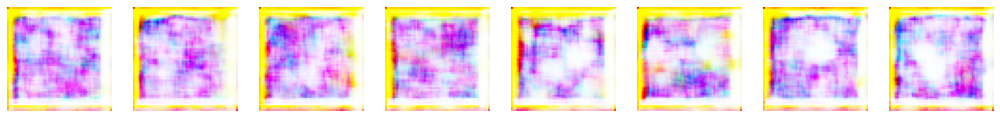

[Step 100] D Loss: 0.2345; G Loss: 1.0928


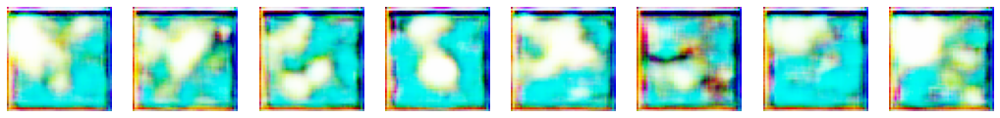

[Step 200] D Loss: 0.0243; G Loss: 9.2648


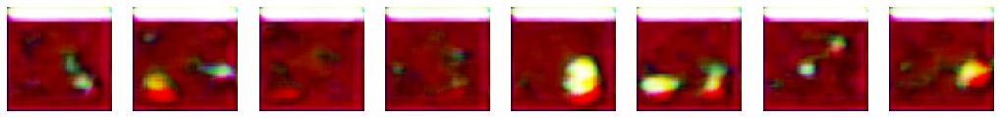

[Step 300] D Loss: 0.6562; G Loss: 0.7795


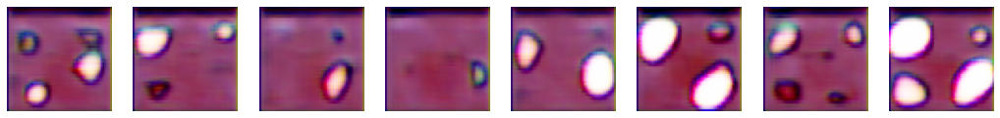

[Step 400] D Loss: 0.0001; G Loss: 13.7875


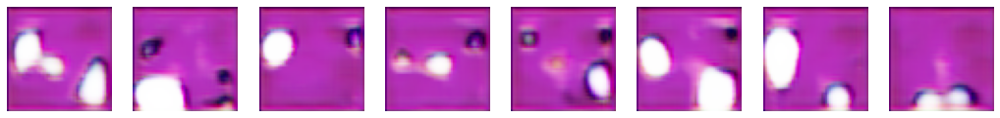

[Step 500] D Loss: 1.8547; G Loss: 4.9406


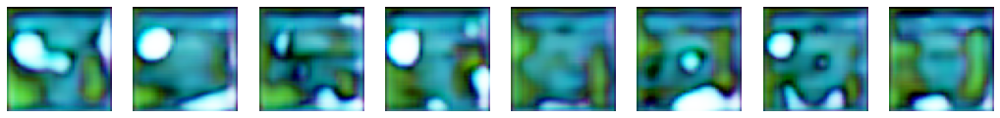

[Step 600] D Loss: 0.3097; G Loss: 0.3647


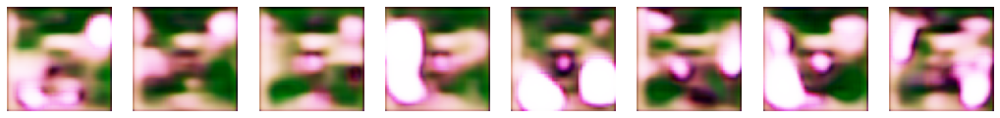

[Step 700] D Loss: 0.7354; G Loss: 2.7829


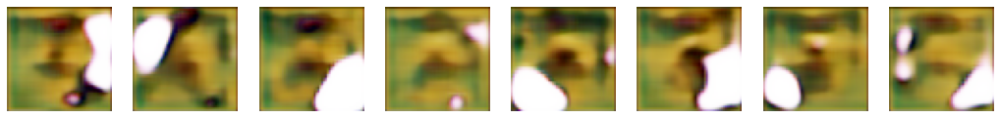

[Step 800] D Loss: 0.2298; G Loss: 4.7232


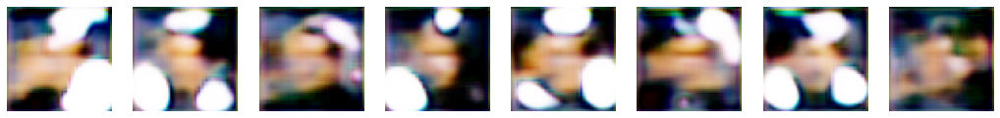

[Step 900] D Loss: 0.4371; G Loss: 8.5145


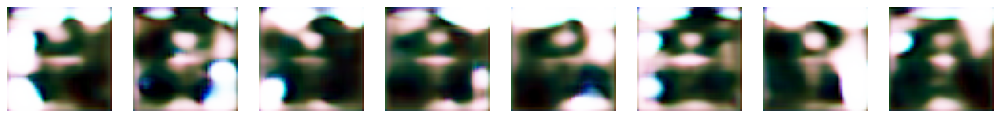

[Step 1000] D Loss: 0.4906; G Loss: 4.0437


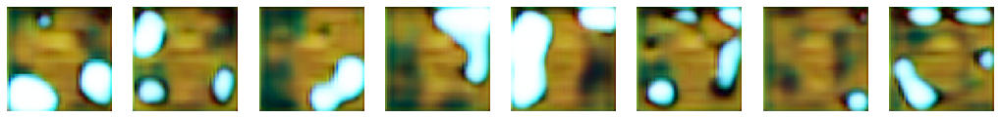

[Step 1100] D Loss: 0.1118; G Loss: 0.5766


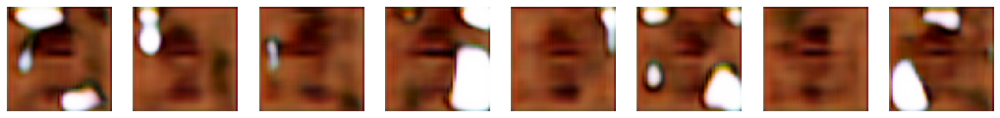

[Step 1200] D Loss: 0.1855; G Loss: 4.4082


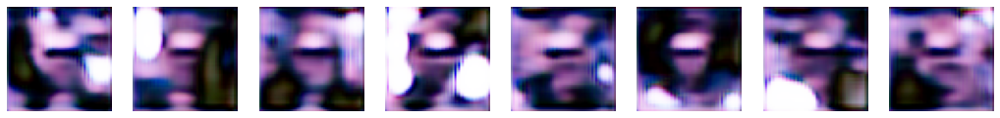

[Step 1300] D Loss: 0.5031; G Loss: 3.7757


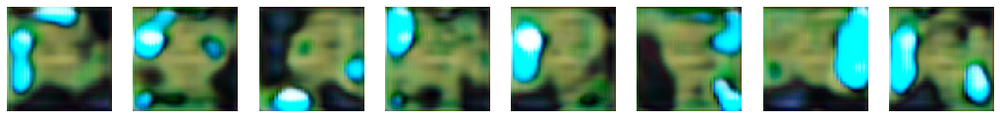

[Step 1400] D Loss: 0.3325; G Loss: 3.7953


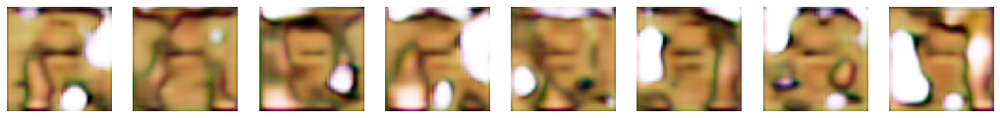

[Step 1500] D Loss: 0.2611; G Loss: 2.8017


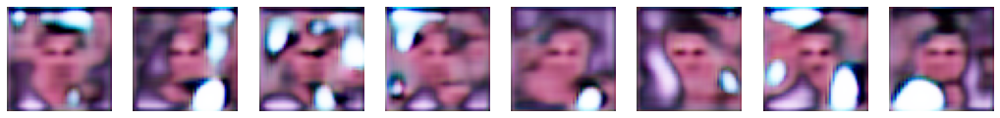

[Step 1600] D Loss: 0.1660; G Loss: 8.9558


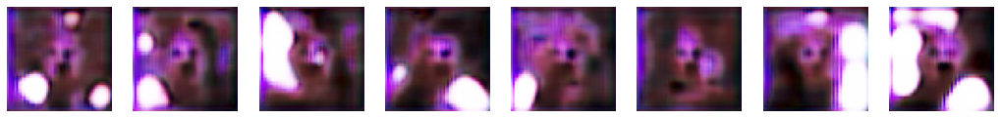

[Step 1700] D Loss: 1.2323; G Loss: 0.5841


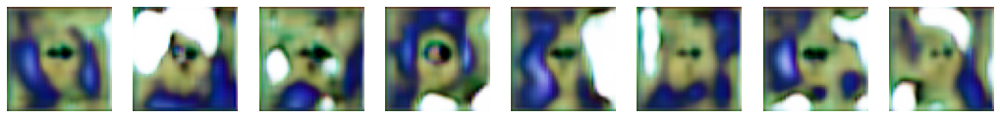

[Step 1800] D Loss: 0.5487; G Loss: 1.4901


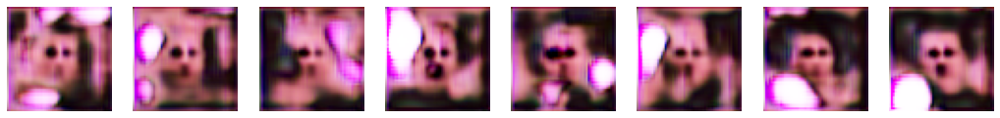

[Step 1900] D Loss: 0.3115; G Loss: 1.1122


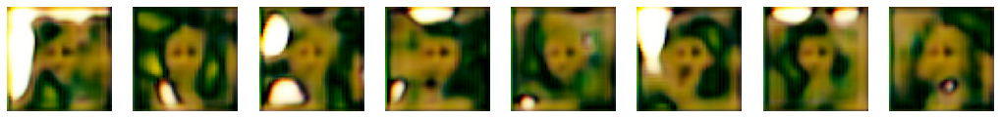

[Step 2000] D Loss: 0.3456; G Loss: 4.7556


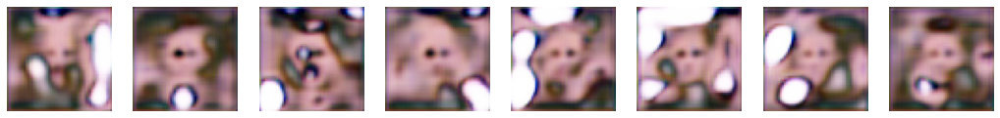

[Step 2100] D Loss: 0.6297; G Loss: 2.6563


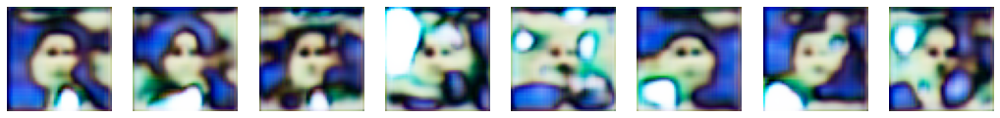

[Step 2200] D Loss: 0.5237; G Loss: 3.8380


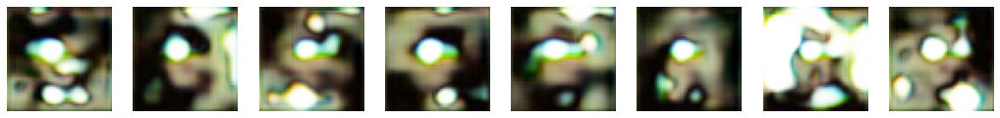

[Step 2300] D Loss: 0.6120; G Loss: 1.2372


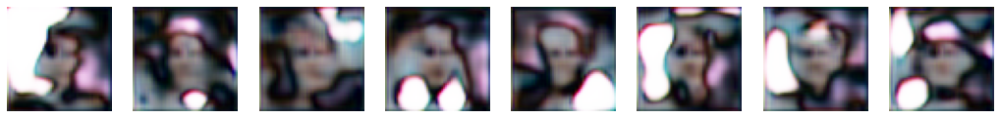

[Step 2400] D Loss: 0.8621; G Loss: 1.3961


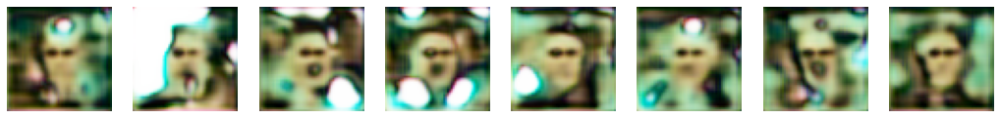

[Step 2500] D Loss: 0.8029; G Loss: 2.8962


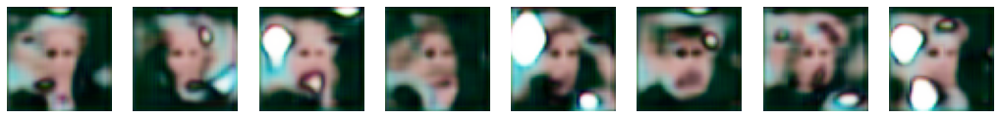

[Step 2600] D Loss: 0.2610; G Loss: 2.4976


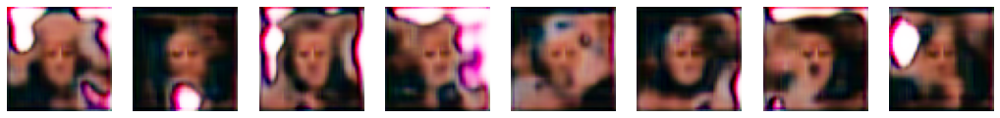

[Step 2700] D Loss: 0.7228; G Loss: 1.0085


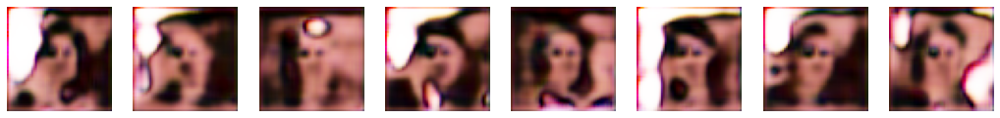

[Step 2800] D Loss: 0.0095; G Loss: 6.3477


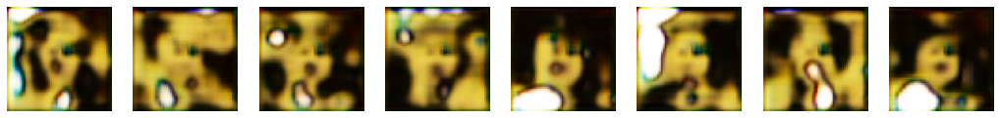

[Step 2900] D Loss: 0.5755; G Loss: 0.0985


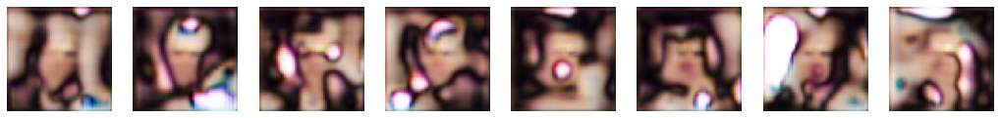

[Step 3000] D Loss: 0.6149; G Loss: 0.7043


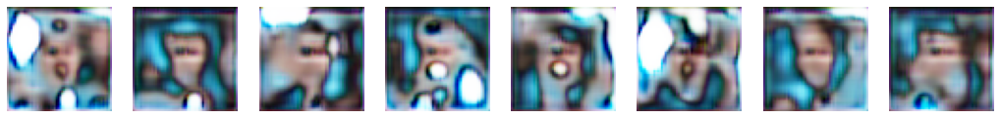

[Step 3100] D Loss: 0.1613; G Loss: 3.3337


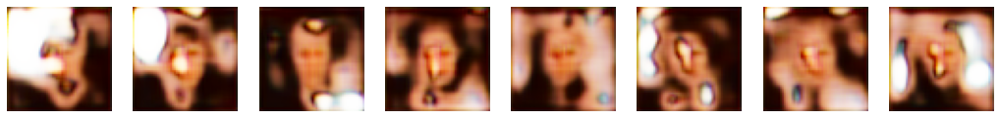

[Step 3200] D Loss: 0.6773; G Loss: 5.1770


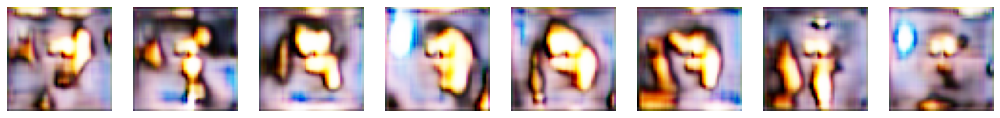

[Step 3300] D Loss: 1.3158; G Loss: 4.3640


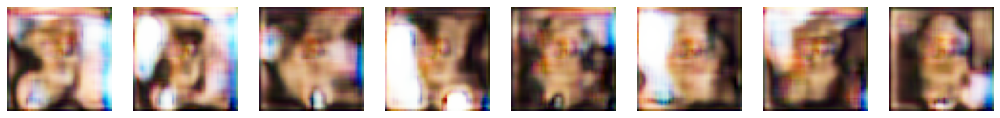

[Step 3400] D Loss: 0.3359; G Loss: 0.6330


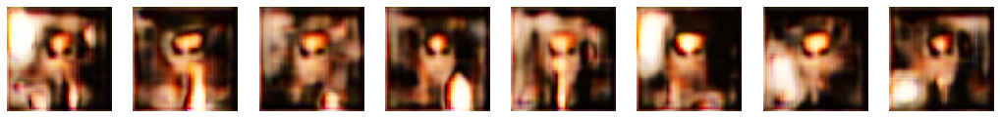

[Step 3500] D Loss: 0.5022; G Loss: 5.6504


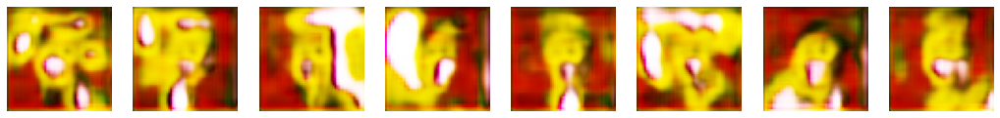

[Step 3600] D Loss: 0.0345; G Loss: 2.1652


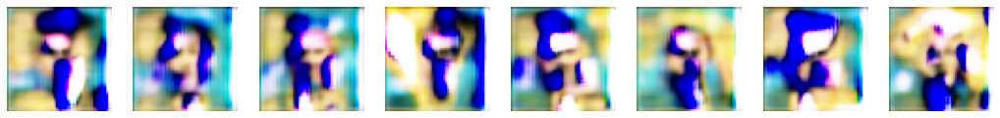

[Step 3700] D Loss: 0.0067; G Loss: 7.5343


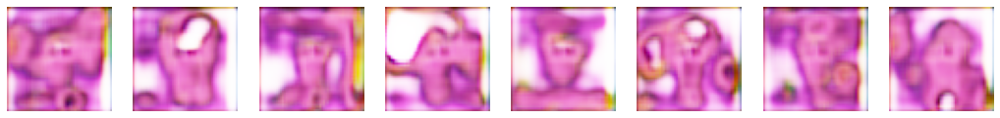

[Step 3800] D Loss: 0.2516; G Loss: 0.0615


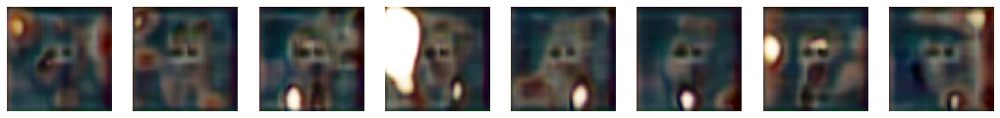

[Step 3900] D Loss: 0.0026; G Loss: 8.5301


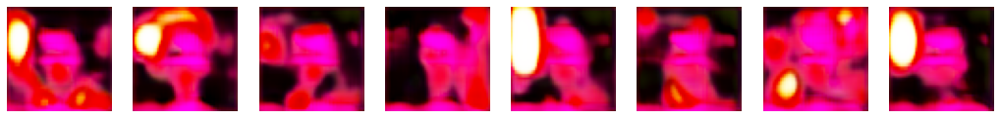

[Step 4000] D Loss: 0.4121; G Loss: 5.0141


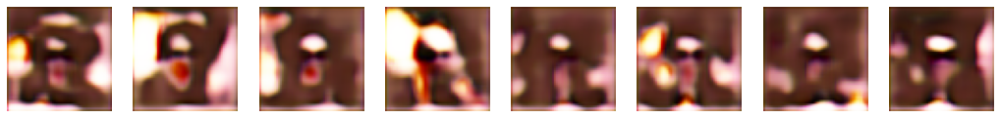

[Step 4100] D Loss: 0.1772; G Loss: 5.8851


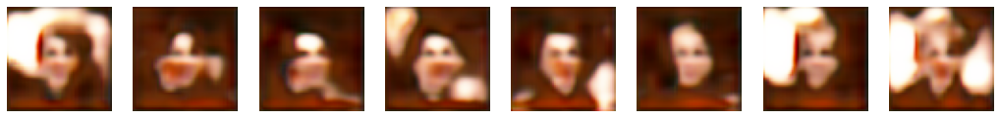

[Step 4200] D Loss: 0.0891; G Loss: 5.7954


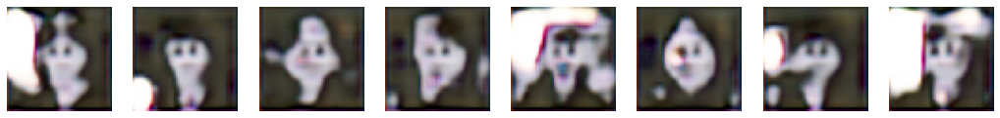

[Step 4300] D Loss: 0.0523; G Loss: 1.3869


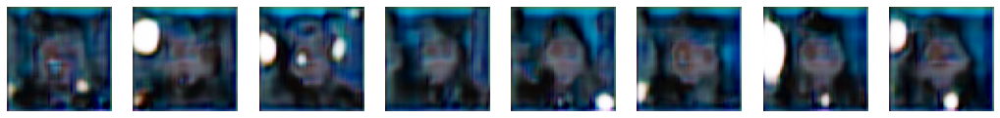

[Step 4400] D Loss: 1.1159; G Loss: 3.6099


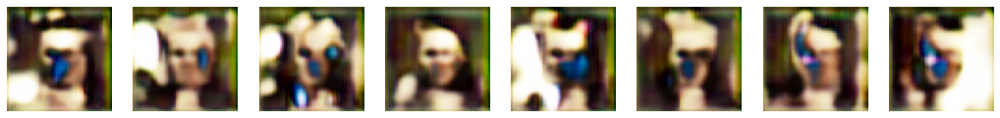

[Step 4500] D Loss: 0.1034; G Loss: 7.1639


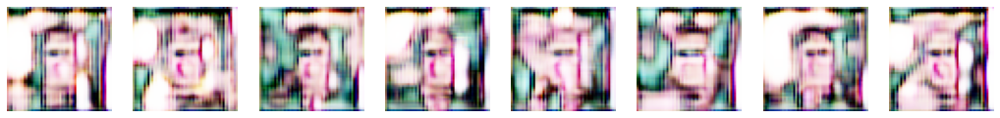

[Step 4600] D Loss: 0.9477; G Loss: 2.9362


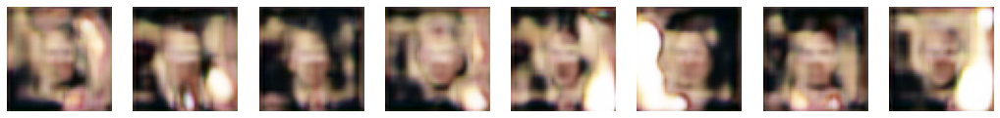

[Step 4700] D Loss: 0.5247; G Loss: 6.5808


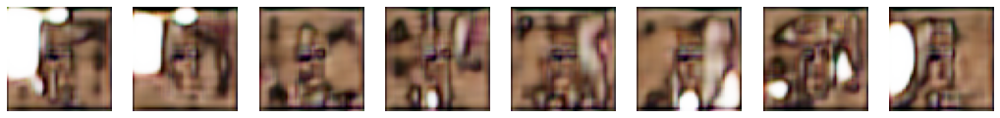

[Step 4800] D Loss: 0.4082; G Loss: 0.5133


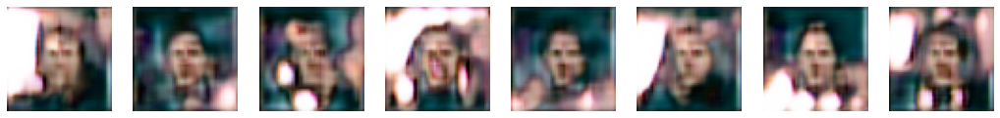

[Step 4900] D Loss: 0.0255; G Loss: 3.5827


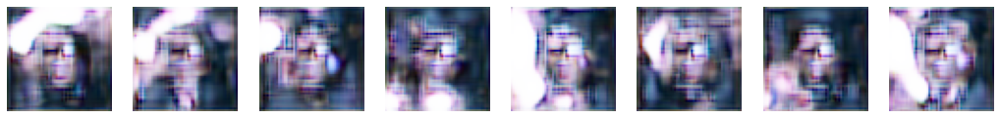

[Step 5000] D Loss: 0.0064; G Loss: 3.8992


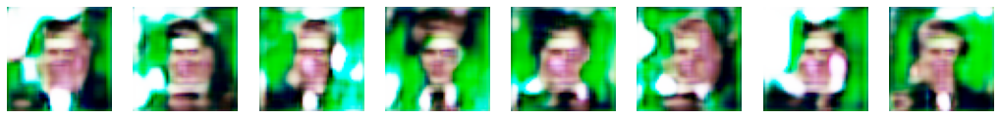

[Step 5100] D Loss: 0.0464; G Loss: 4.6735


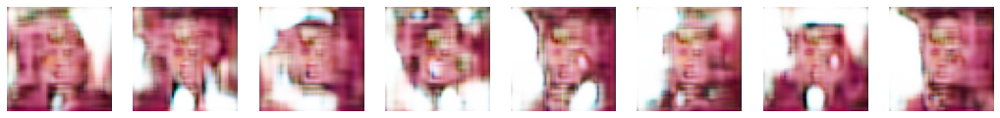

[Step 5200] D Loss: 0.4216; G Loss: 4.8146


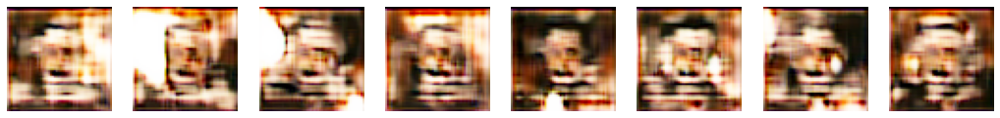

[Step 5300] D Loss: 0.2516; G Loss: 5.9070


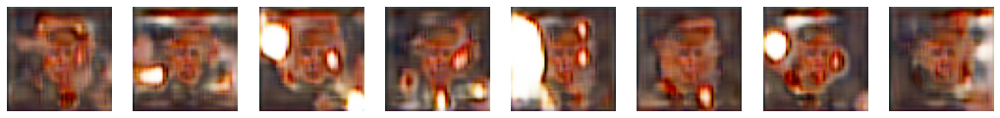

[Step 5400] D Loss: 0.5176; G Loss: 1.4923


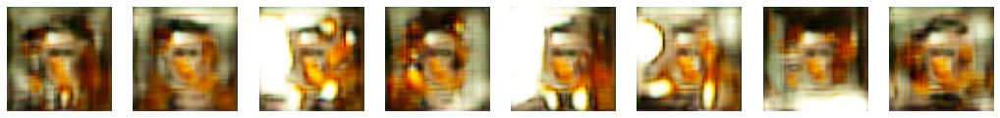

[Step 5500] D Loss: 0.3522; G Loss: 6.1986


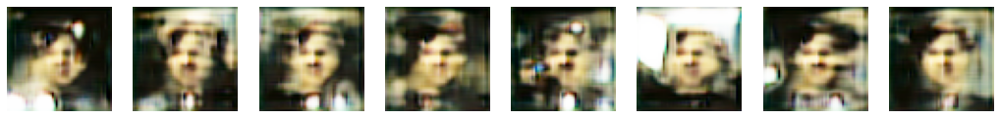

[Step 5600] D Loss: 0.1303; G Loss: 3.0233


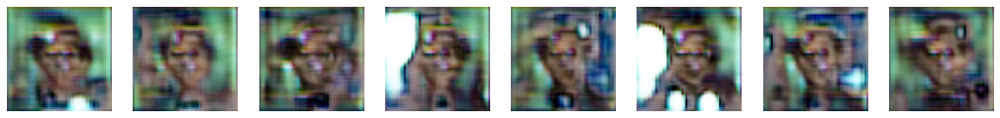

[Step 5700] D Loss: 0.0905; G Loss: 0.8943


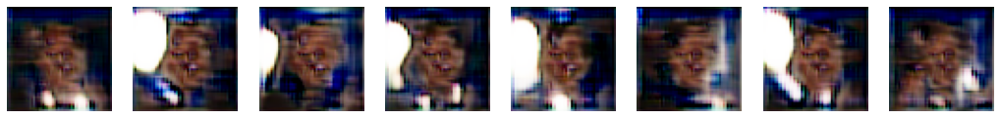

[Step 5800] D Loss: 0.6205; G Loss: 0.0702


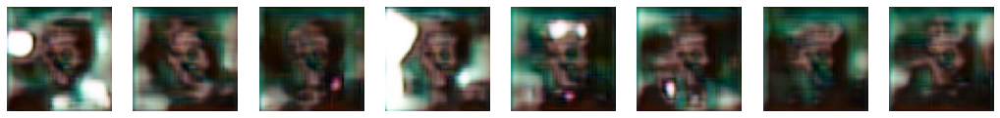

[Step 5900] D Loss: 0.8209; G Loss: 1.2745


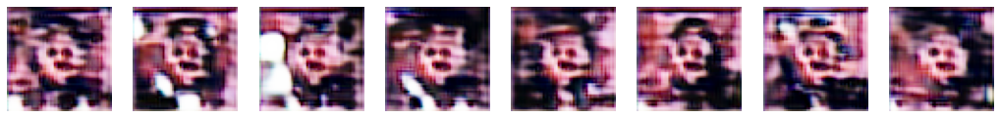

[Step 6000] D Loss: 0.0475; G Loss: 5.1308


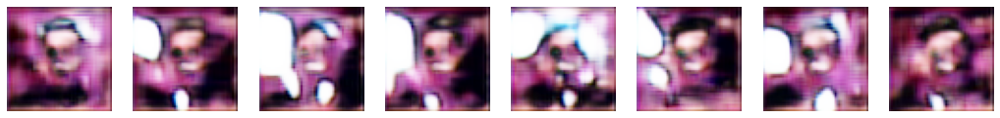

[Step 6100] D Loss: 0.8765; G Loss: 6.1076


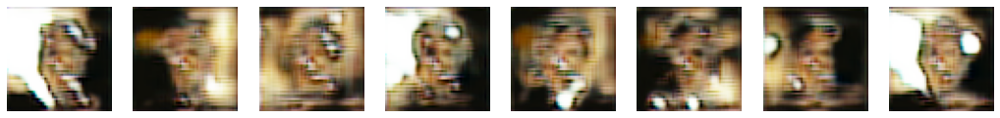

[Step 6200] D Loss: 0.0153; G Loss: 7.3873


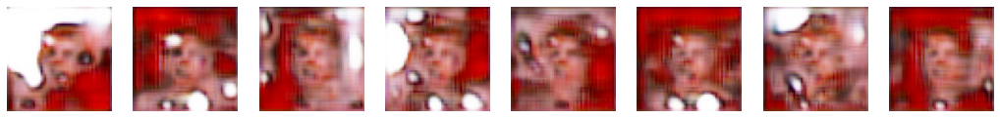

[Step 6300] D Loss: 0.1152; G Loss: 4.8738


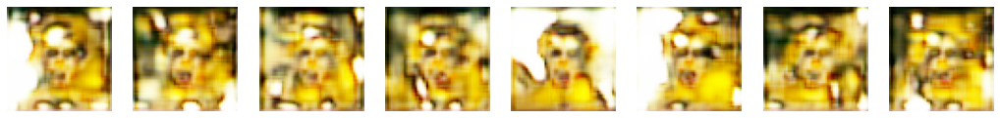

[Step 6400] D Loss: 0.4105; G Loss: 5.8469


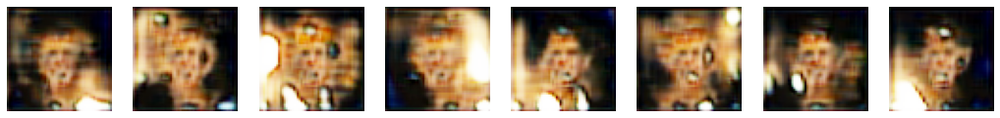

[Step 6500] D Loss: 0.1474; G Loss: 5.2566


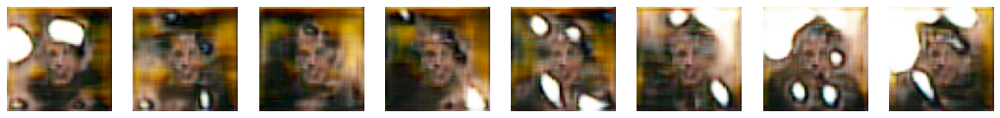

[Step 6600] D Loss: 0.2297; G Loss: 3.0051


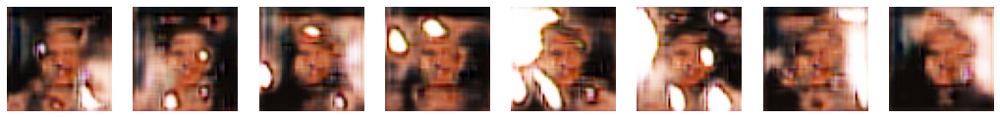

[Step 6700] D Loss: 0.5359; G Loss: 5.3071


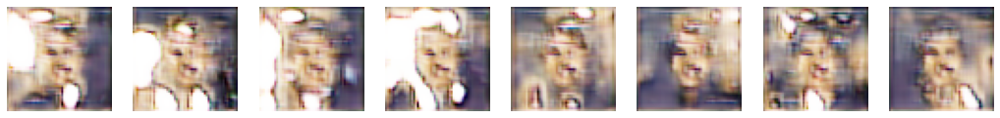

[Step 6800] D Loss: 0.1904; G Loss: 1.8776


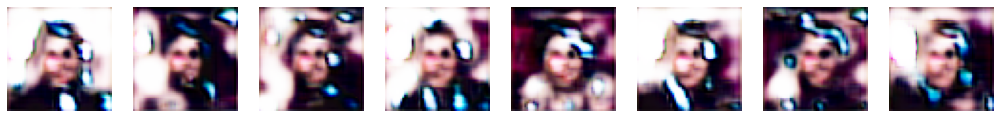

[Step 6900] D Loss: 0.2045; G Loss: 2.5402


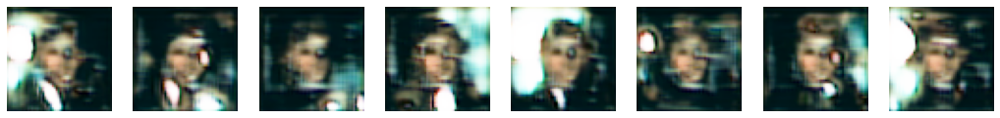

[Step 7000] D Loss: 0.2096; G Loss: 2.9858


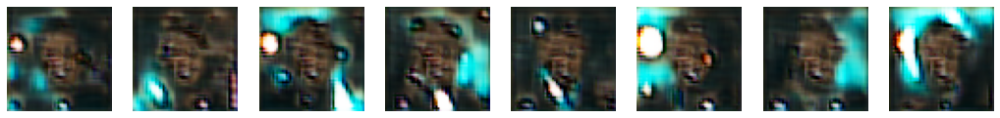

[Step 7100] D Loss: 0.3793; G Loss: 2.7257


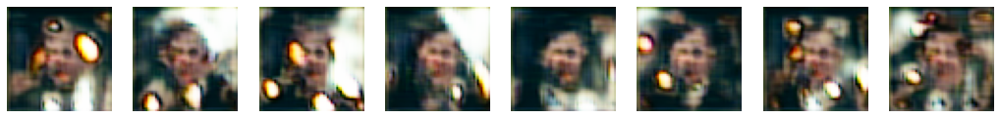

[Step 7200] D Loss: 0.1589; G Loss: 3.5866


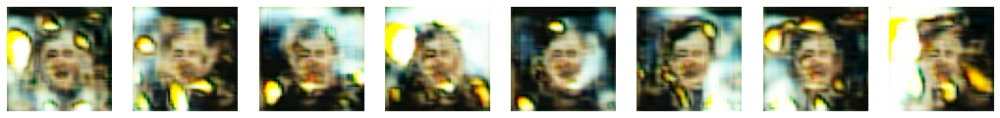

[Step 7300] D Loss: 0.4885; G Loss: 1.8467


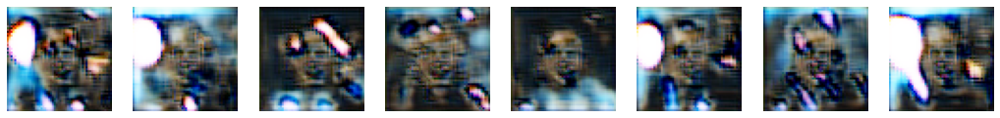

[Step 7400] D Loss: 0.6106; G Loss: 3.2340


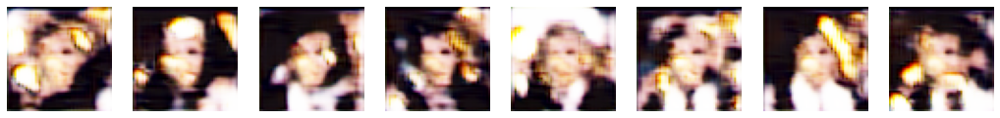

[Step 7500] D Loss: 0.3251; G Loss: 7.4724


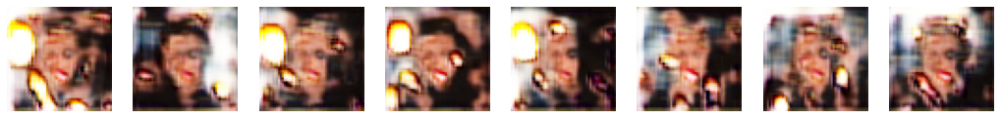

[Step 7600] D Loss: 0.0818; G Loss: 6.0775


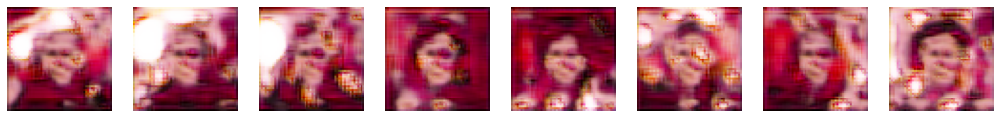

[Step 7700] D Loss: 0.3278; G Loss: 1.9581


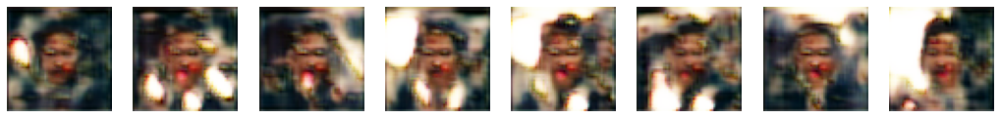

[Step 7800] D Loss: 0.1897; G Loss: 3.5567


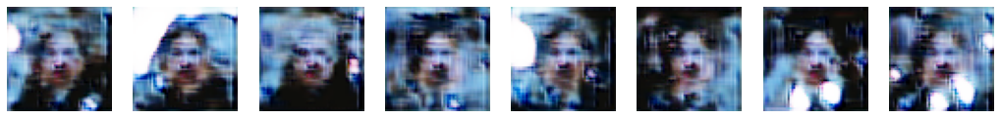

[Step 7900] D Loss: 0.0557; G Loss: 3.1877


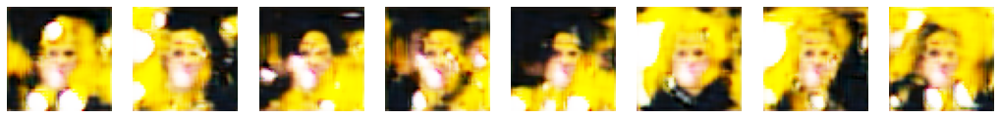

[Step 8000] D Loss: 0.3012; G Loss: 1.9765


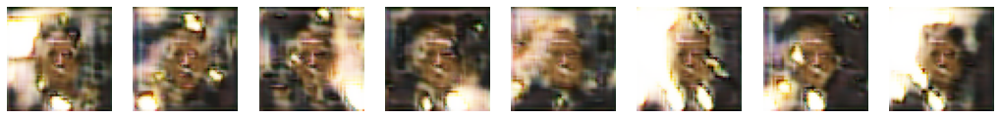

[Step 8100] D Loss: 0.3795; G Loss: 2.5806


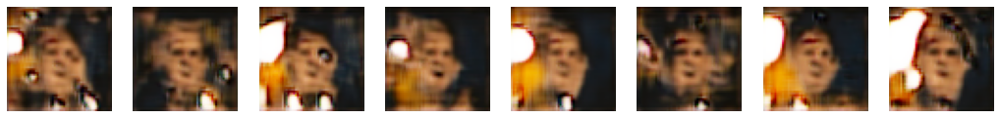

[Step 8200] D Loss: 0.4473; G Loss: 2.5322


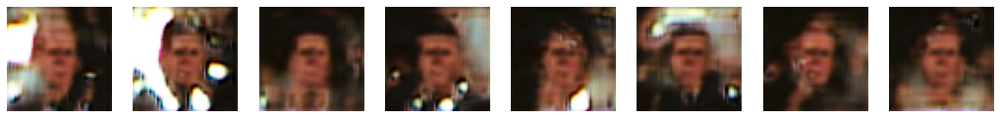

[Step 8300] D Loss: 0.0987; G Loss: 2.2319


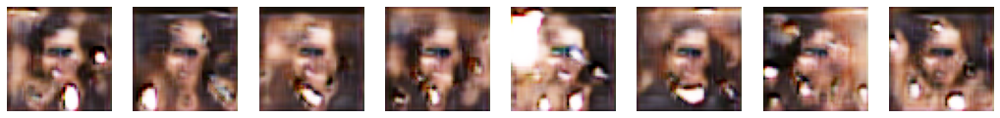

[Step 8400] D Loss: 0.5034; G Loss: 2.0945


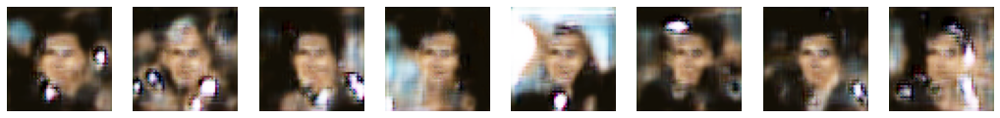

[Step 8500] D Loss: 0.4294; G Loss: 0.0134


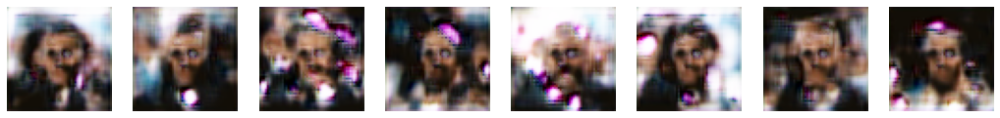

[Step 8600] D Loss: 0.1809; G Loss: 4.6061


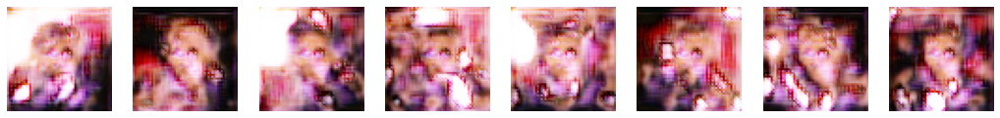

[Step 8700] D Loss: 0.0234; G Loss: 5.0275


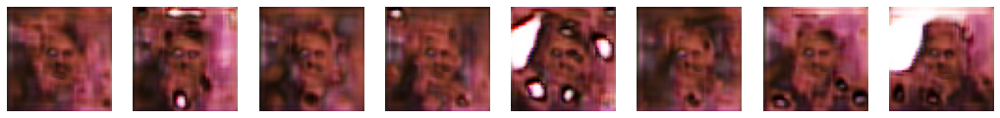

[Step 8800] D Loss: 0.2127; G Loss: 6.3403


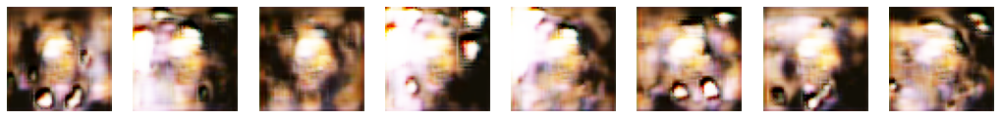

[Step 8900] D Loss: 0.7007; G Loss: 2.7638


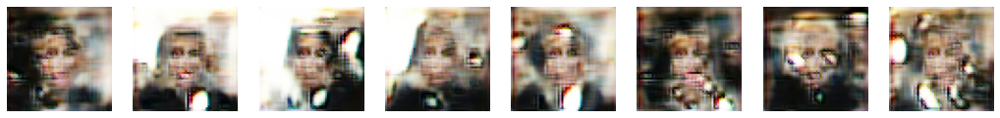

[Step 9000] D Loss: 0.3401; G Loss: 4.1403


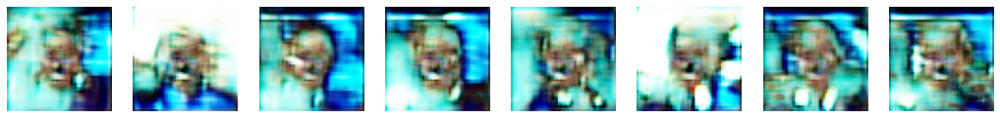

[Step 9100] D Loss: 0.6822; G Loss: 3.6465


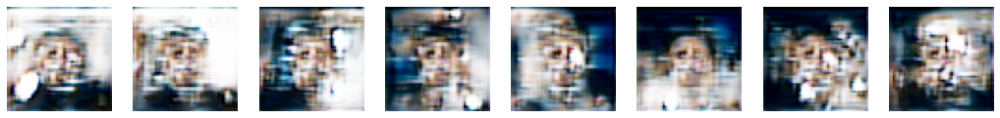

[Step 9200] D Loss: 0.0065; G Loss: 5.2230


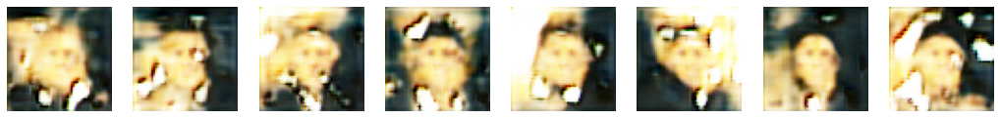

[Step 9300] D Loss: 0.4254; G Loss: 3.4596


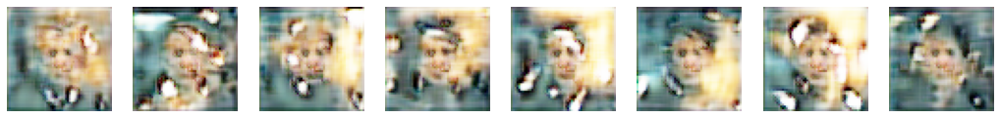

[Step 9400] D Loss: 0.1185; G Loss: 2.6710


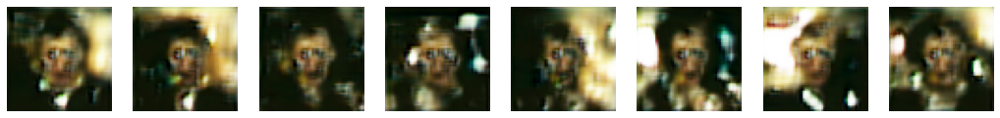

[Step 9500] D Loss: 0.5618; G Loss: 4.3016


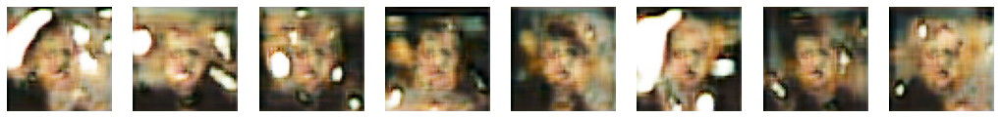

[Step 9600] D Loss: 0.0708; G Loss: 4.8165


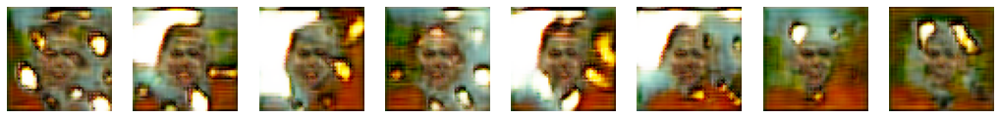

[Step 9700] D Loss: 0.1852; G Loss: 3.7079


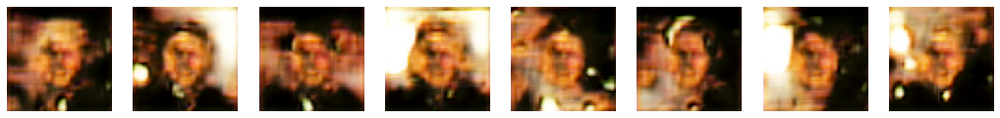

[Step 9800] D Loss: 0.2139; G Loss: 6.1408


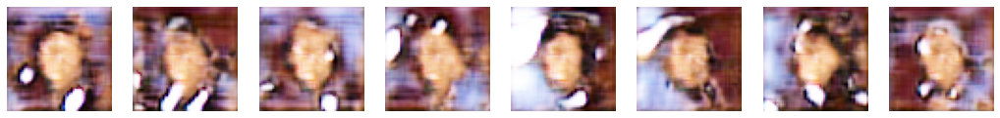

[Step 9900] D Loss: 0.1976; G Loss: 2.4109


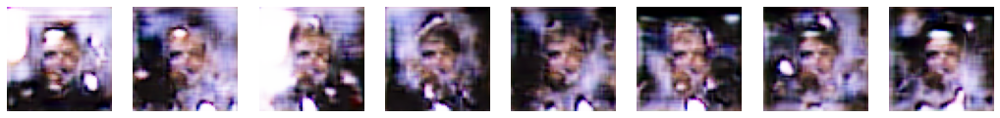

[Step 10000] D Loss: 0.3647; G Loss: 2.3913


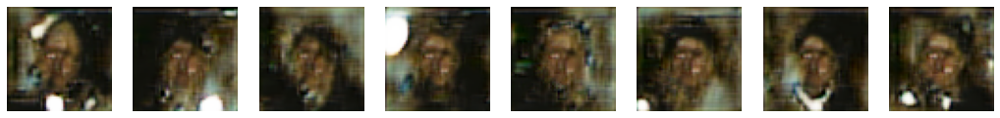

[Step 10100] D Loss: 0.1004; G Loss: 2.5993


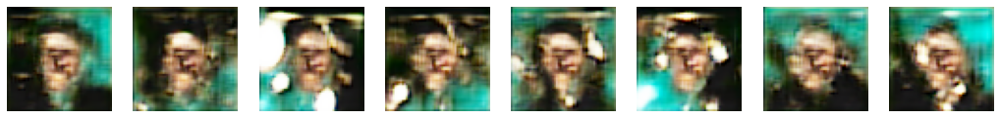

[Step 10200] D Loss: 0.6572; G Loss: 3.5873


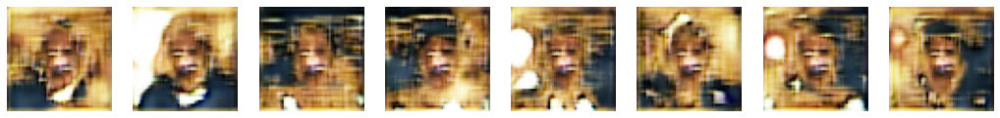

[Step 10300] D Loss: 0.0675; G Loss: 3.0102


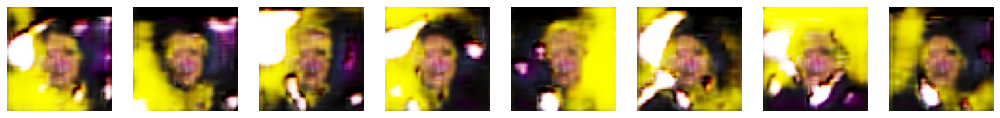

[Step 10400] D Loss: 0.1956; G Loss: 0.0264


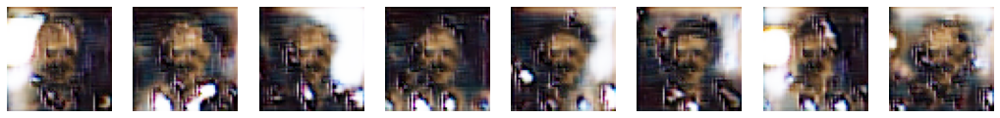

[Step 10500] D Loss: 0.3527; G Loss: 4.5726


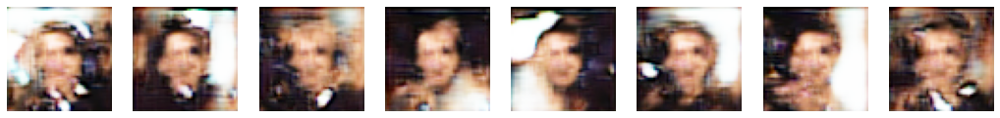

[Step 10600] D Loss: 0.0523; G Loss: 3.1824


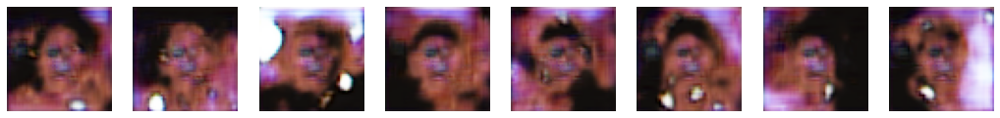

[Step 10700] D Loss: 0.3012; G Loss: 0.4385


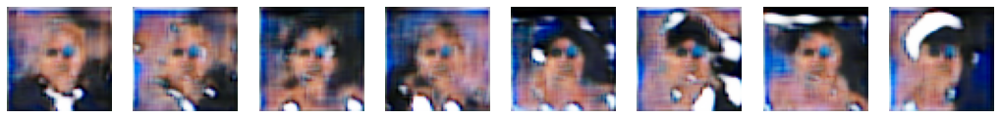

[Step 10800] D Loss: 0.1425; G Loss: 7.9169


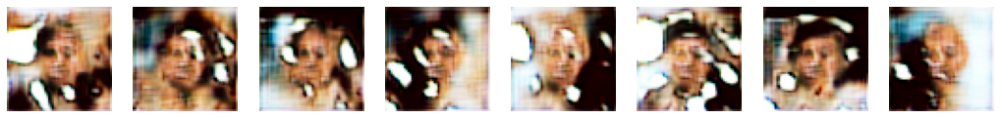

[Step 10900] D Loss: 0.0304; G Loss: 3.2777


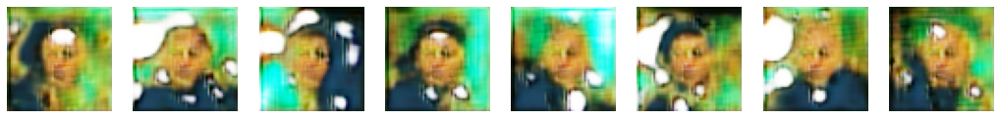

[Step 11000] D Loss: 0.0518; G Loss: 2.1285


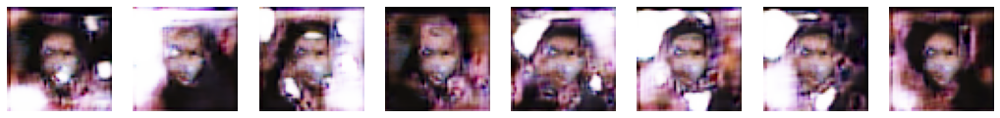

[Step 11100] D Loss: 0.2937; G Loss: 4.1207


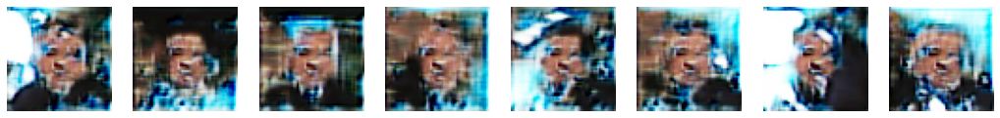

[Step 11200] D Loss: 0.5262; G Loss: 2.3414


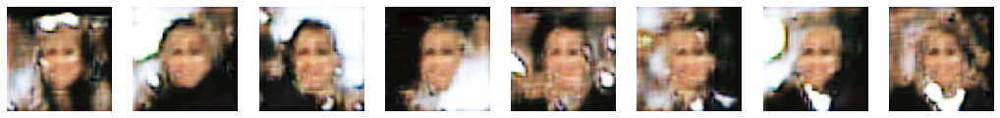

[Step 11300] D Loss: 0.0155; G Loss: 7.1752


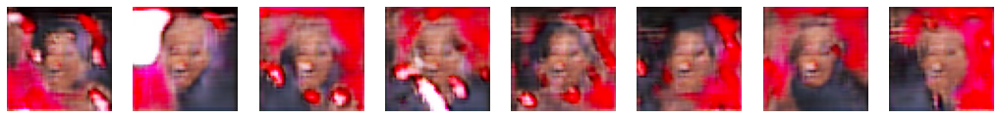

[Step 11400] D Loss: 0.1426; G Loss: 4.7501


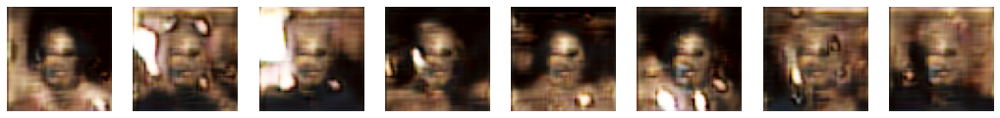

[Step 11500] D Loss: 0.1199; G Loss: 4.1073


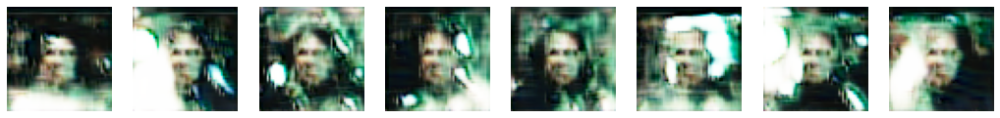

In [ ]:
for step, true_images in enumerate(train_ds):
    
    # Train Discriminator
    
    noise = np.random.normal(0, 1, (HALF_BATCH_SIZE, INPUT_DIM)).astype(np.float32)
    syntetic_images = generator.predict(noise)
    x_combined = np.concatenate((
        true_images, 
        syntetic_images))
    y_combined = np.concatenate((
        np.ones((HALF_BATCH_SIZE, 1), np.float32), 
        np.zeros((HALF_BATCH_SIZE, 1), np.float32)))
    
    with tf.GradientTape() as tape:
        logits = discriminator(x_combined, training=True)
        d_loss_value = sigmoid_cross_entropy(y_combined, logits)
    grads = tape.gradient(d_loss_value, discriminator.trainable_variables)
    optimizer.apply_gradients(zip(grads, discriminator.trainable_variables))
    
    # Train Generator
    
    noise = np.random.normal(0, 1, (BATCH_SIZE, INPUT_DIM)).astype(np.float32)
    y_mislabled = np.ones((BATCH_SIZE, 1), np.float32)
    
    with tf.GradientTape() as tape:
        syntetic = generator(noise, training=True)
        logits = discriminator(syntetic, training=False)
        g_loss_value = sigmoid_cross_entropy(y_mislabled, logits)
    grads = tape.gradient(g_loss_value, generator.trainable_variables)
    optimizer.apply_gradients(zip(grads, generator.trainable_variables))
    
    # Check intermediate results
    
    if step % 100 == 0:
        print('[Step %2d] D Loss: %.4f; G Loss: %.4f' % (
            step, d_loss_value.numpy(), g_loss_value.numpy()))
        noise = np.random.normal(0, 1, (8, INPUT_DIM)).astype(np.float32)
        syntetic_images = generator.predict(noise)
        syntetic_images = syntetic_images*255
        syntetic_images = syntetic_images.astype(int)
        syntetic_images = np.clip(syntetic_images, 0, 255)
        
        plt.figure(figsize=(18, 2))
        for i in range(syntetic_images.shape[0]):
            plt.subplot(1, 8, i+1)
            plt.imshow(syntetic_images[i])
            plt.axis('off')
        plt.show()
        ckpt_manager.save()

In [ ]:
print(step)

11577


In [ ]:
initial_step = 34722

In [ ]:
def learning(initial_step):
  for step, true_images in enumerate(train_ds):
      
      # Train Discriminator
      
      noise = np.random.normal(0, 1, (HALF_BATCH_SIZE, INPUT_DIM)).astype(np.float32)
      syntetic_images = generator.predict(noise)
      x_combined = np.concatenate((
          true_images, 
          syntetic_images))
      y_combined = np.concatenate((
          np.ones((HALF_BATCH_SIZE, 1), np.float32), 
          np.zeros((HALF_BATCH_SIZE, 1), np.float32)))
      
      with tf.GradientTape() as tape:
          logits = discriminator(x_combined, training=True)
          d_loss_value = sigmoid_cross_entropy(y_combined, logits)
      grads = tape.gradient(d_loss_value, discriminator.trainable_variables)
      optimizer.apply_gradients(zip(grads, discriminator.trainable_variables))
      
      # Train Generator
      
      noise = np.random.normal(0, 1, (BATCH_SIZE, INPUT_DIM)).astype(np.float32)
      y_mislabled = np.ones((BATCH_SIZE, 1), np.float32)
      
      with tf.GradientTape() as tape:
          syntetic = generator(noise, training=True)
          logits = discriminator(syntetic, training=False)
          g_loss_value = sigmoid_cross_entropy(y_mislabled, logits)
      grads = tape.gradient(g_loss_value, generator.trainable_variables)
      optimizer.apply_gradients(zip(grads, generator.trainable_variables))
      
      # Check intermediate results
      
      if (step + initial_step) % 1000 == 0:
          print('[Step %2d] D Loss: %.4f; G Loss: %.4f' % (
              step + initial_step, d_loss_value.numpy(), g_loss_value.numpy()))
          noise = np.random.normal(0, 1, (8, INPUT_DIM)).astype(np.float32)
          syntetic_images = generator.predict(noise)
          syntetic_images = syntetic_images*255
          syntetic_images = syntetic_images.astype(int)
          syntetic_images = np.clip(syntetic_images, 0, 255)
          
          plt.figure(figsize=(18, 2))
          for i in range(syntetic_images.shape[0]):
              plt.subplot(1, 8, i+1)
              plt.imshow(syntetic_images[i])
              plt.axis('off')
          plt.show()
          ckpt_manager.save()
  return step + initial_step

In [ ]:
initial_step = learning(initial_step)
print(initial_step)
ckpt_manager.save()

In [ ]:
initial_step = learning(initial_step)
print(initial_step)
ckpt_manager.save()

In [ ]:
initial_step = learning(initial_step)
print(initial_step)
ckpt_manager.save()

In [ ]:
initial_step = learning(initial_step)
print(initial_step)
ckpt_manager.save()

In [ ]:
initial_step = learning(initial_step)
print(initial_step)
ckpt_manager.save()

[Step 93000] D Loss: 0.0005; G Loss: 0.0000


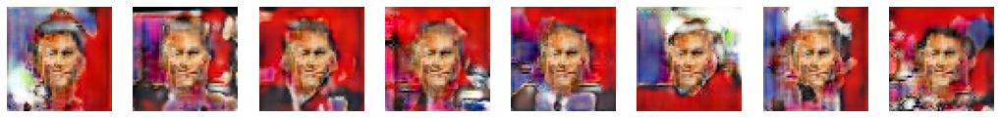

[Step 94000] D Loss: 0.0003; G Loss: 2.2614


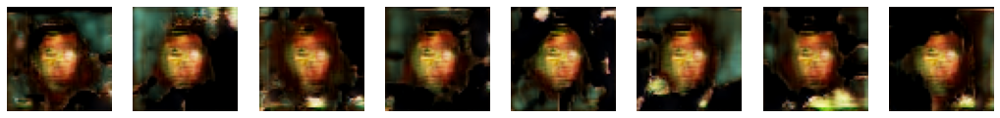

[Step 95000] D Loss: 0.0006; G Loss: 0.0008


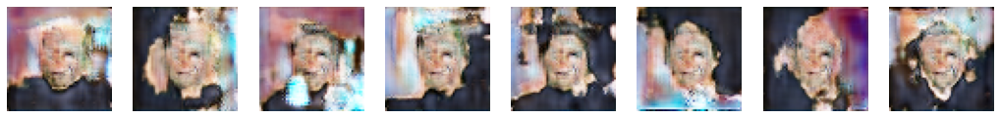

[Step 96000] D Loss: 0.0001; G Loss: 2.3258


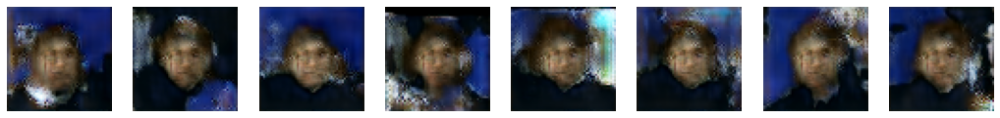

[Step 97000] D Loss: 0.0001; G Loss: 0.4959


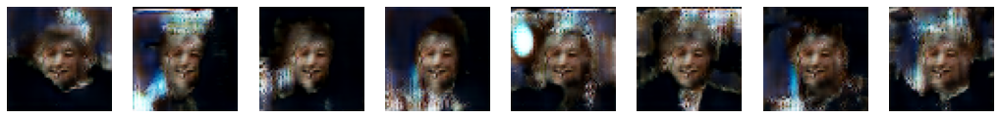

[Step 98000] D Loss: 0.0045; G Loss: 0.5823


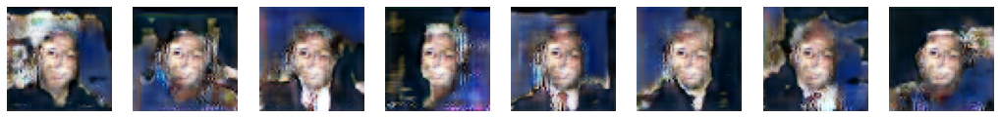

[Step 99000] D Loss: 0.0000; G Loss: 0.0002


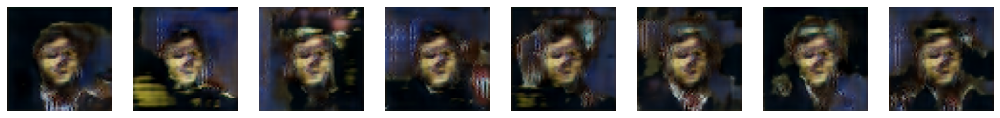

[Step 100000] D Loss: 0.0000; G Loss: 0.0000


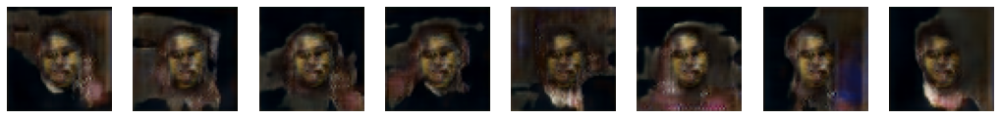

[Step 101000] D Loss: 0.0018; G Loss: 0.2624


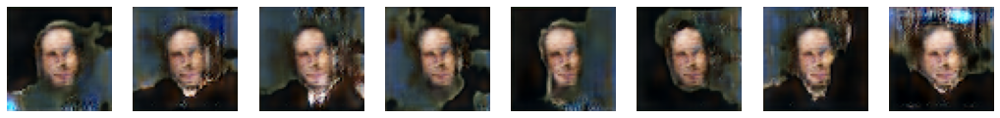

[Step 102000] D Loss: 0.0483; G Loss: 0.0000


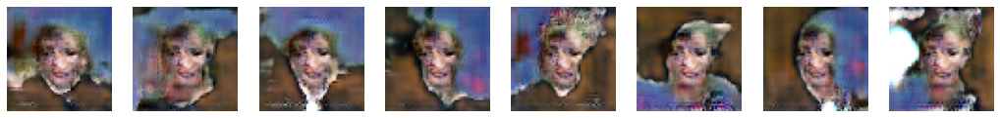

[Step 103000] D Loss: 0.0011; G Loss: 0.0911


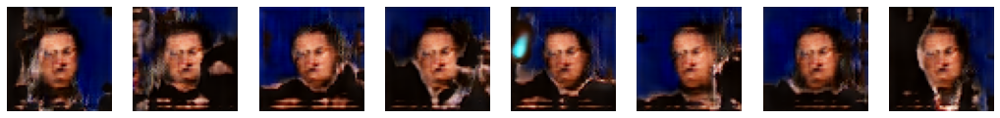

[Step 104000] D Loss: 0.0004; G Loss: 0.0000


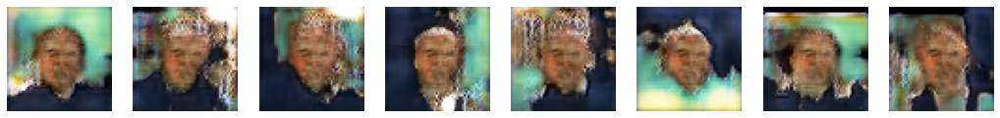

104184


'/content/gdrive/My Drive/AI/GB/CV/Lesson8/CPS/ckpt-426'

In [ ]:
initial_step = learning(initial_step)
print(initial_step)
ckpt_manager.save()